<a href="https://colab.research.google.com/github/regenbuild/BIM2BEM/blob/main/TrimeshNetworkTest.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!pip install trimesh
!pip install git+https://github.com/2twenity/topologicpy.git#egg=topologicpy

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 704.8/704.8 kB 9.0 MB/s eta 0:00:00
  Cloning https://github.com/2twenity/topologicpy.git to /tmp/pip-install-8r6f6bmy/topologicpy_3710c8b2ac844808878de1932f4d23f0
  Running command git clone --filter=blob:none --quiet https://github.com/2twenity/topologicpy.git /tmp/pip-install-8r6f6bmy/topologicpy_3710c8b2ac844808878de1932f4d23f0
  Resolved https://github.com/2twenity/topologicpy.git to commit 922431e454e443f72759e3164c14edaed97f04a4
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 16.8/16.8 MB 49.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 111.0/111.0 kB 7.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 136.0/136.0 kB 9.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 60.8/60.8 kB 3.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━

In [2]:
!pip install torch_geometric

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 63.1/63.1 kB 1.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 16.2 MB/s eta 0:00:00


In [3]:
import numpy as np
import trimesh

In [4]:
from topologicpy.Vertex import Vertex
from topologicpy.Face import Face
from topologicpy.Cell import Cell
from topologicpy.CellComplex import CellComplex
from topologicpy.Cluster import Cluster

from topologicpy.Topology import Topology
from topologicpy.Graph import Graph
from topologicpy.Dictionary import Dictionary
from topologicpy.Color import Color

from topologicpy.EnergyModel import EnergyModel
from topologicpy.Speckle import Speckle
# from topologicpy.Neo4j import Neo4j

# from scipy.spatial import ConvexHull

In [5]:
TOKEN = ""

client = Speckle.ClientByURL(url="https://app.speckle.systems/", token=TOKEN)

streams = Speckle.StreamsByClient(client)
stream = streams[1]

branches = Speckle.BranchesByStream(client=client, stream=stream)
branch = branches[0]

commits = Speckle.CommitsByBranch(branch=branch)
commit = commits[0]

obj = Speckle.SpeckleObject(client=client, stream=stream, branch=branch, commit=commit)

toplogy_obj = Speckle.TopologyBySpeckleObject(obj)

client = Speckle.ClientByURL(url="https://app.speckle.systems/", token=TOKEN)

streams = Speckle.StreamsByClient(client)
stream = streams[1]

branches = Speckle.BranchesByStream(client=client, stream=stream)
branch = branches[0]

commits = Speckle.CommitsByBranch(branch=branch)
commit = commits[0]

obj = Speckle.SpeckleObject(client=client, stream=stream, branch=branch, commit=commit)

topology_obj = Speckle.TopologyBySpeckleObject(obj, returnVertices=False)

In [6]:
# data = {'Wall':[], 'Slab':[], 'Space':[], 'Door':[], 'Window':[]}
data = {}

for element in topology_obj:
  # print(element)
  # lst = data[element[0]]
  # lst.append(element[1:4])
  # data[element[0]] = lst
  name = element[1]

  data[element[1]] = [element[3], element[0], name]

In [ ]:
print(data)

{'IfcSlab/Basic Roof:RF_Stimip_50:398206': [[[[-31.84741973876953, -0.3899714946746826, 10.50601577758789, -31.84741973876953, -0.3899714946746826, 10.406015396118164, -31.84741973876953, 2.228595733642578, 10.406015396118164, -31.84741973876953, 2.228595733642578, 10.50601577758789, -33.04523468017578, 2.228595733642578, 10.406015396118164, -33.04523468017578, 2.228595733642578, 10.50601577758789, -33.04523468017578, -0.3899714946746826, 10.406015396118164, -33.04523468017578, -0.3899714946746826, 10.50601577758789], [3, 0, 1, 2, 3, 3, 0, 2, 3, 3, 2, 4, 3, 5, 3, 4, 3, 5, 4, 6, 3, 7, 5, 6, 3, 7, 6, 1, 3, 0, 7, 1, 3, 6, 4, 2, 3, 1, 6, 2, 3, 3, 5, 7, 3, 3, 7, 0]], [[-31.84741973876953, -0.3899714946746826, 10.886014938354492, -31.84741973876953, -0.3899714946746826, 10.50601577758789, -31.84741973876953, 2.228595733642578, 10.50601577758789, -31.84741973876953, 2.228595733642578, 10.886014938354492, -33.04523468017578, 2.228595733642578, 10.50601577758789, -33.04523468017578, 2.228595733

# Slabs

In [ ]:
first_obj = next(topology_obj)

In [ ]:
print(first_obj)

['Slab', 'IfcSlab/Basic Roof:RF_Stimip_50:398206', '6ed87750a5b4fbd9dea99f4c737c25fc', [[[-31.84741973876953, -0.3899714946746826, 10.50601577758789, -31.84741973876953, -0.3899714946746826, 10.406015396118164, -31.84741973876953, 2.228595733642578, 10.406015396118164, -31.84741973876953, 2.228595733642578, 10.50601577758789, -33.04523468017578, 2.228595733642578, 10.406015396118164, -33.04523468017578, 2.228595733642578, 10.50601577758789, -33.04523468017578, -0.3899714946746826, 10.406015396118164, -33.04523468017578, -0.3899714946746826, 10.50601577758789], [3, 0, 1, 2, 3, 3, 0, 2, 3, 3, 2, 4, 3, 5, 3, 4, 3, 5, 4, 6, 3, 7, 5, 6, 3, 7, 6, 1, 3, 0, 7, 1, 3, 6, 4, 2, 3, 1, 6, 2, 3, 3, 5, 7, 3, 3, 7, 0]], [[-31.84741973876953, -0.3899714946746826, 10.886014938354492, -31.84741973876953, -0.3899714946746826, 10.50601577758789, -31.84741973876953, 2.228595733642578, 10.50601577758789, -31.84741973876953, 2.228595733642578, 10.886014938354492, -33.04523468017578, 2.228595733642578, 10.5060

## Trimesh Process

In [ ]:
meshes = first_obj[3]
first_mesh = meshes[0]
second_mesh = meshes[1]
third_mesh = meshes[2]

In [ ]:
print(transform_faces(first_mesh[1]))
print(transform_vertices(first_mesh[0]))

[[0, 1, 2], [3, 0, 2], [3, 2, 4], [5, 3, 4], [5, 4, 6], [7, 5, 6], [7, 6, 1], [0, 7, 1], [6, 4, 2], [1, 6, 2], [3, 5, 7], [3, 7, 0]]
[[-31.84741973876953, -0.3899714946746826, 10.50601577758789], [-31.84741973876953, -0.3899714946746826, 10.406015396118164], [-31.84741973876953, 2.228595733642578, 10.406015396118164], [-31.84741973876953, 2.228595733642578, 10.50601577758789], [-33.04523468017578, 2.228595733642578, 10.406015396118164], [-33.04523468017578, 2.228595733642578, 10.50601577758789], [-33.04523468017578, -0.3899714946746826, 10.406015396118164], [-33.04523468017578, -0.3899714946746826, 10.50601577758789]]


In [ ]:
# print(first_mesh[0])
# print(transform_faces(first_mesh[1]))

first_trimesh = trimesh.Trimesh(vertices=transform_vertices(first_mesh[0]), faces=transform_faces(first_mesh[1]))
second_trimesh = trimesh.Trimesh(vertices=transform_vertices(second_mesh[0]), faces=transform_faces(second_mesh[1]))
third_trimesh = trimesh.Trimesh(vertices=transform_vertices(third_mesh[0]), faces=transform_faces(third_mesh[1]))

In [ ]:
first_trimesh.show()

In [ ]:
print(first_trimesh.vertices)
print(first_trimesh.faces)

[[-31.84741974  -0.38997149  10.50601578]
 [-31.84741974  -0.38997149  10.4060154 ]
 [-31.84741974   2.22859573  10.4060154 ]
 [-31.84741974   2.22859573  10.50601578]
 [-33.04523468   2.22859573  10.4060154 ]
 [-33.04523468   2.22859573  10.50601578]
 [-33.04523468  -0.38997149  10.4060154 ]
 [-33.04523468  -0.38997149  10.50601578]]
[[0 1 2]
 [3 0 2]
 [3 2 4]
 [5 3 4]
 [5 4 6]
 [7 5 6]
 [7 6 1]
 [0 7 1]
 [6 4 2]
 [1 6 2]
 [3 5 7]
 [3 7 0]]


In [ ]:
second_trimesh.show()

In [ ]:
print(second_trimesh.vertices)
print(second_trimesh.faces)

[[-31.84741974  -0.38997149  10.88601494]
 [-31.84741974  -0.38997149  10.50601578]
 [-31.84741974   2.22859573  10.50601578]
 [-31.84741974   2.22859573  10.88601494]
 [-33.04523468   2.22859573  10.50601578]
 [-33.04523468   2.22859573  10.88601494]
 [-33.04523468  -0.38997149  10.50601578]
 [-33.04523468  -0.38997149  10.88601494]]
[[0 1 2]
 [3 0 2]
 [3 2 4]
 [5 3 4]
 [5 4 6]
 [7 5 6]
 [7 6 1]
 [0 7 1]
 [6 4 2]
 [1 6 2]
 [3 5 7]
 [3 7 0]]


In [ ]:
third_trimesh.show()

In [ ]:
print(third_trimesh.vertices)
print(third_trimesh.faces)

[[-31.84741974  -0.38997149  10.9060154 ]
 [-31.84741974  -0.38997149  10.88601494]
 [-31.84741974   2.22859573  10.88601494]
 [-31.84741974   2.22859573  10.9060154 ]
 [-33.04523468   2.22859573  10.88601494]
 [-33.04523468   2.22859573  10.9060154 ]
 [-33.04523468  -0.38997149  10.88601494]
 [-33.04523468  -0.38997149  10.9060154 ]]
[[0 1 2]
 [3 0 2]
 [3 2 4]
 [5 3 4]
 [5 4 6]
 [7 5 6]
 [7 6 1]
 [0 7 1]
 [6 4 2]
 [1 6 2]
 [3 5 7]
 [3 7 0]]


In [ ]:
merged = trimesh.util.concatenate([first_trimesh, second_trimesh, third_trimesh])
print("Len vert:", len(merged.vertices))
print("Len faces:", len(merged.faces))

Len vert: 24
Len faces: 36


In [ ]:
merged.show()

In [ ]:
merged.merge_vertices()
print("Len vert:", len(merged.vertices))
print("Len faces:", len(merged.faces))

Len vert: 16
Len faces: 36


In [ ]:
print(merged.vertices)
print(merged.faces)

[[-31.84741974  -0.38997149  10.50601578]
 [-31.84741974  -0.38997149  10.4060154 ]
 [-31.84741974   2.22859573  10.4060154 ]
 [-31.84741974   2.22859573  10.50601578]
 [-33.04523468   2.22859573  10.4060154 ]
 [-33.04523468   2.22859573  10.50601578]
 [-33.04523468  -0.38997149  10.4060154 ]
 [-33.04523468  -0.38997149  10.50601578]
 [-31.84741974  -0.38997149  10.88601494]
 [-31.84741974   2.22859573  10.88601494]
 [-33.04523468   2.22859573  10.88601494]
 [-33.04523468  -0.38997149  10.88601494]
 [-31.84741974  -0.38997149  10.9060154 ]
 [-31.84741974   2.22859573  10.9060154 ]
 [-33.04523468   2.22859573  10.9060154 ]
 [-33.04523468  -0.38997149  10.9060154 ]]
[[ 0  1  2]
 [ 3  0  2]
 [ 3  2  4]
 [ 5  3  4]
 [ 5  4  6]
 [ 7  5  6]
 [ 7  6  1]
 [ 0  7  1]
 [ 6  4  2]
 [ 1  6  2]
 [ 3  5  7]
 [ 3  7  0]
 [ 8  0  3]
 [ 9  8  3]
 [ 9  3  5]
 [10  9  5]
 [10  5  7]
 [11 10  7]
 [11  7  0]
 [ 8 11  0]
 [ 7  5  3]
 [ 0  7  3]
 [ 9 10 11]
 [ 9 11  8]
 [12  8  9]
 [13 12  9]
 [13  9 10]
 [1

In [ ]:
merged.show()

## Topologic Process

In [ ]:
def make_topologic_vertices(array):
  if len(array) == 3:
    return Vertex.ByCoordinates(array[0], array[1], array[2])

slab_topologic_vertices_list = []

for vertices in merged.vertices:
  slab_topologic_vertices_list.append(make_topologic_vertices(vertices))

print(len(slab_topologic_vertices_list))
print(slab_topologic_vertices_list[4])

16


In [ ]:
def make_topologic_faces(vertices, faces):
  faces_list = []

  for faces in merged.faces:
    required_vertices = [vertices[faces[0]], vertices[faces[1]], vertices[faces[2]]]
    # print(required_vertices)
    face = Face.ByVertices(required_vertices)

    faces_list.append(face)

  return faces_list

slabs_topologic_faces = make_topologic_faces(vertices = slab_topologic_vertices_list, faces = merged.faces)

print(slabs_topologic_faces)

[<topologic_core.Face object at 0x7f4eff7b0970>, <topologic_core.Face object at 0x7f4f0137c070>, <topologic_core.Face object at 0x7f4efa554cf0>, <topologic_core.Face object at 0x7f4ef9b88cf0>, <topologic_core.Face object at 0x7f4efa76a730>, <topologic_core.Face object at 0x7f4ef9b8a3b0>, <topologic_core.Face object at 0x7f4efe08af70>, <topologic_core.Face object at 0x7f4f0065f8b0>, <topologic_core.Face object at 0x7f4eff008b30>, <topologic_core.Face object at 0x7f4f00ef2270>, <topologic_core.Face object at 0x7f4f014205b0>, <topologic_core.Face object at 0x7f4ef9b8aff0>, <topologic_core.Face object at 0x7f4ef9b8b1b0>, <topologic_core.Face object at 0x7f4ef97df2f0>, <topologic_core.Face object at 0x7f4ef97df3b0>, <topologic_core.Face object at 0x7f4ef97df670>, <topologic_core.Face object at 0x7f4ef97df7b0>, <topologic_core.Face object at 0x7f4ef97dd7b0>, <topologic_core.Face object at 0x7f4ef97dc4f0>, <topologic_core.Face object at 0x7f4ef97dc9f0>, <topologic_core.Face object at 0x7f4ef9

In [ ]:
Topology.Show(slabs_topologic_faces, renderer='colab', vertexSize=3)

# Walls

In [ ]:
print(data['Wall'][0])

['IfcWall/Basic Wall:WA_Int_BrickWall_46:395783', 'e507afb3583723027cd967c5576b248d', [[[-20.882247924804688, 10.717159271240234, 10.406015396118164, -20.882247924804688, 10.717159271240234, 5.406015396118164, -20.882247924804688, 10.697159767150879, 5.406015396118164, -20.882247924804688, 10.697159767150879, 10.406015396118164, -11.015806198120117, 10.717157363891602, 10.406015396118164, -11.015806198120117, 10.697157859802246, 10.406015396118164, -11.015806198120117, 10.717157363891602, 5.406015396118164, -11.015806198120117, 10.697157859802246, 5.406015396118164, -15.217248916625977, 10.697158813476562, 5.456014633178711, -16.537248611450195, 10.717158317565918, 5.456014633178711, -16.537248611450195, 10.697158813476562, 5.456014633178711, -15.217248916625977, 10.717158317565918, 5.456014633178711, -15.217248916625977, 10.717158317565918, 7.776015281677246, -15.217248916625977, 10.697158813476562, 7.776015281677246, -16.537248611450195, 10.717158317565918, 7.776015281677246, -16.537

## Trimesh Process

In [ ]:
def make_trimesh(pack):
  # print("Iteration is ", iteration)
  # print(pack)
  geometry = pack[2]

  def transform_faces(initial_mesh):
    l = len(initial_mesh)
    i = 0

    result = []
    while i<l:
      slice_length = initial_mesh[i]
      i+=1
      sli = initial_mesh[i:i+slice_length]
      result.append(sli)
      i+=slice_length

    return result

  def transform_vertices(initial_mesh):
    l = len(initial_mesh)
    i = 0

    result = []
    while i<l:
      result.append(initial_mesh[i:i+3])
      i+=3

    return result

  meshes = []
  for piece in geometry:
    t = trimesh.Trimesh(vertices=transform_vertices(piece[0]), faces=transform_faces(piece[1]))

    for submesh in t.split():
      meshes.append(submesh)

  return meshes

In [ ]:
wall_meshes = []

for wall in data['Wall']:
  wall_meshes.append(make_trimesh(wall))

KeyError: 'Wall'

In [ ]:
print(wall_meshes)

[[<trimesh.Trimesh(vertices.shape=(16, 3), faces.shape=(32, 3))>, <trimesh.Trimesh(vertices.shape=(16, 3), faces.shape=(32, 3))>, <trimesh.Trimesh(vertices.shape=(16, 3), faces.shape=(32, 3))>], [<trimesh.Trimesh(vertices.shape=(16, 3), faces.shape=(32, 3))>, <trimesh.Trimesh(vertices.shape=(16, 3), faces.shape=(32, 3))>, <trimesh.Trimesh(vertices.shape=(16, 3), faces.shape=(32, 3))>, <trimesh.Trimesh(vertices.shape=(16, 3), faces.shape=(32, 3))>, <trimesh.Trimesh(vertices.shape=(16, 3), faces.shape=(32, 3))>, <trimesh.Trimesh(vertices.shape=(16, 3), faces.shape=(32, 3))>], [<trimesh.Trimesh(vertices.shape=(16, 3), faces.shape=(32, 3))>, <trimesh.Trimesh(vertices.shape=(16, 3), faces.shape=(32, 3))>, <trimesh.Trimesh(vertices.shape=(16, 3), faces.shape=(32, 3))>, <trimesh.Trimesh(vertices.shape=(16, 3), faces.shape=(32, 3))>, <trimesh.Trimesh(vertices.shape=(16, 3), faces.shape=(32, 3))>, <trimesh.Trimesh(vertices.shape=(16, 3), faces.shape=(32, 3))>], [<trimesh.Trimesh(vertices.shape=

In [ ]:
# Merging walls
merged_walls = []

for wall in wall_meshes:
  merged_walls.append(trimesh.util.concatenate(wall))

In [ ]:
res = trimesh.boolean.intersection([merged_walls[0], merged_walls[11]])

In [ ]:
ures = trimesh.boolean.union([merged_walls[0], merged_walls[11], merged_walls[3]])

In [ ]:
print(ures)

<trimesh.Trimesh(vertices.shape=(109, 3), faces.shape=(302, 3))>


In [ ]:
res.show()

In [ ]:
ures.show()

In [ ]:
res.show()

In [ ]:
merged_walls[190].show()

In [ ]:
conv = trimesh.collision.mesh_to_convex(merged_walls[193])

AttributeError: 'NoneType' object has no attribute 'Convex'

In [ ]:
print(bound_193)

<trimesh.primitives.Box>


In [ ]:
bound_193.show()

In [ ]:
print(merged_walls[193].body_count)

6


In [ ]:
#merging all
merged_floors = trimesh.util.concatenate(merged_walls)

In [ ]:
merged_floors.show()

In [ ]:
g = wall_meshes[0][0].vertex_adjacency_graph

In [ ]:
wall_meshes[0][0].show()

## Topologic Process

In [ ]:
def make_topologic_vertices(array):
  if len(array) == 3:
    return Vertex.ByCoordinates(array[0], array[1], array[2])

walls_topologic_vertices_list = []

for vertices in ch.vertices:
  walls_topologic_vertices_list.append(make_topologic_vertices(vertices))

print(len(walls_topologic_vertices_list))
print(walls_topologic_vertices_list)

20
[<topologic_core.Vertex object at 0x7f4efa38e9f0>, <topologic_core.Vertex object at 0x7f4efa38fd70>, <topologic_core.Vertex object at 0x7f4efa38d1b0>, <topologic_core.Vertex object at 0x7f4efa38edf0>, <topologic_core.Vertex object at 0x7f4efa38f3b0>, <topologic_core.Vertex object at 0x7f4efa38d4f0>, <topologic_core.Vertex object at 0x7f4efa38fa30>, <topologic_core.Vertex object at 0x7f4efa38c5b0>, <topologic_core.Vertex object at 0x7f4efa38c8f0>, <topologic_core.Vertex object at 0x7f4efa38f370>, <topologic_core.Vertex object at 0x7f4efa38fb30>, <topologic_core.Vertex object at 0x7f4efa38e530>, <topologic_core.Vertex object at 0x7f4efa38ef70>, <topologic_core.Vertex object at 0x7f4efa38eab0>, <topologic_core.Vertex object at 0x7f4efa38e070>, <topologic_core.Vertex object at 0x7f4efa38ef30>, <topologic_core.Vertex object at 0x7f4efa38c530>, <topologic_core.Vertex object at 0x7f4efa38eaf0>, <topologic_core.Vertex object at 0x7f4efa38fdb0>, <topologic_core.Vertex object at 0x7f4efa38e33

In [ ]:
def make_topologic_faces(obj, vertices, faces):
  faces_list = []

  for faces in obj.faces:
    required_vertices = [vertices[faces[0]], vertices[faces[1]], vertices[faces[2]]]
    # print(required_vertices)
    face = Face.ByVertices(required_vertices)

    faces_list.append(face)

  return faces_list

walls_topologic_faces = make_topologic_faces(obj=ch, vertices = walls_topologic_vertices_list, faces = ch.faces)

print(len(walls_topologic_faces))
print(walls_topologic_faces)

36
[<topologic_core.Face object at 0x7f4efa318630>, <topologic_core.Face object at 0x7f4efa319930>, <topologic_core.Face object at 0x7f4efa318130>, <topologic_core.Face object at 0x7f4efa31ae30>, <topologic_core.Face object at 0x7f4efa31b870>, <topologic_core.Face object at 0x7f4efa31a730>, <topologic_core.Face object at 0x7f4efa31a3b0>, <topologic_core.Face object at 0x7f4efa31a7b0>, <topologic_core.Face object at 0x7f4efa2e1930>, <topologic_core.Face object at 0x7f4efa31a2b0>, <topologic_core.Face object at 0x7f4efa2e0cb0>, <topologic_core.Face object at 0x7f4efa2e03b0>, <topologic_core.Face object at 0x7f4efa2e0730>, <topologic_core.Face object at 0x7f4efa2e2270>, <topologic_core.Face object at 0x7f4efa2e27f0>, <topologic_core.Face object at 0x7f4efa2e1e70>, <topologic_core.Face object at 0x7f4efa2e0ff0>, <topologic_core.Face object at 0x7f4efa2e2230>, <topologic_core.Face object at 0x7f4efa2e11f0>, <topologic_core.Face object at 0x7f4efa2e25f0>, <topologic_core.Face object at 0x7f4

# Door

In [ ]:
def make_topologic_door_cell(iteration, pack):
  print("Iteration is ", iteration, " Pack name:", pack[1])
  geometry = pack[0]

  def check_geometry_size(meshes):
    total = 0
    for mesh in meshes:
      total += len(mesh[1])

    return total

  def transform_faces(initial_mesh):
    l = len(initial_mesh)
    i = 0

    result = []
    while i<l:
      slice_length = initial_mesh[i]
      i+=1
      sli = initial_mesh[i:i+slice_length]
      result.append(sli)
      i+=slice_length

    return result

  def transform_vertices(initial_mesh):
    l = len(initial_mesh)
    i = 0

    result = []
    while i<l:
      mesh = initial_mesh[i:i+3]
      rounded_mesh = [round(x, 2) for x in mesh]
      result.append(rounded_mesh)
      i+=3

    return result

  def topologies_from_numpy(arr):
    res = []

    for vertices in arr:
      v1 = Vertex.ByCoordinates(vertices[0][0],
                                vertices[0][1],
                                vertices[0][2])
      v2 = Vertex.ByCoordinates(vertices[1][0],
                                vertices[1][1],
                                vertices[1][2])
      v3 = Vertex.ByCoordinates(vertices[2][0],
                                vertices[2][1],
                                vertices[2][2])

      face = Face.ByVertices([v1, v2, v3])
      res.append(face)

    return res

  def simplify_topology(cells):
    if len(cells) > 1:
      cell_complex = CellComplex.ByCells(cells)

      try:
        return CellComplex.ExternalBoundary(cell_complex)
      except:
        print("Failure!!", iteration)
    else:
      print("Wow! Simple element was found")
      return cells[0]


  #Metadata Section
  d = Dictionary.ByPythonDictionary({"category": pack[1], "full_name": pack[2]})

  #Main execution
  cells = []

  if check_geometry_size(geometry) > 1000:
    print("Heavy Obj, need convex hull")
    trimeshes_list = []
    for piece in geometry:
      t = trimesh.Trimesh(vertices=transform_vertices(piece[0]), faces=transform_faces(piece[1]))
      trimeshes_list.append(t)

    overall_mesh = trimesh.util.concatenate(trimeshes_list)
    ch = overall_mesh.convex_hull

    faces = topologies_from_numpy(ch.vertices[ch.faces])
    cell = Cell.ByFaces(faces)
    Topology.AddDictionary(cell, d)
    return cell

  else:
    for piece in geometry:
      t = trimesh.Trimesh(vertices=transform_vertices(piece[0]), faces=transform_faces(piece[1]))

      for submesh in t.split():
        faces = topologies_from_numpy(submesh.vertices[submesh.faces])
        cell = Cell.ByFaces(faces)

        cells.append(cell)

  simp = simplify_topology(cells)
  Topology.AddDictionary(simp, d)

  return simp

In [ ]:
corridor_door = data['IfcDoor/Doors_IntSgl:DR_5486x7010cm-1shutter:395767']
corridor_door_geometry = corridor_door[0]

res = make_topologic_door_cell(0, corridor_door)
print(Dictionary.PythonDictionary(Topology.Dictionary(res)))

# print(sum(len(corridor_door_geometry[i]) for i in corridor_door_geometry))

Iteration is  0  Pack name: Door
Heavy Obj, need convex hull
{'category': 'Door', 'full_name': 'IfcDoor/Doors_IntSgl:DR_5486x7010cm-1shutter:395767'}


# Overall Topology

## Zones Selection

In [8]:
#Room 432
space432 = data['IfcSpace/432']
external_wall_432_1 = data['IfcWall/Basic Wall:WA_Ext_BrickWall_64-(2+1)_Plaster:395558']
external_wall_432_2 = data['IfcWall/Basic Wall:WA_Ext_BrickWall_64-(2+1)_Plaster:395560']
upper_slab_432 = data['IfcSlab/Basic Roof:RF_Stimip_50:397900']
lower_slab_432_1 = data['IfcSlab/Floor:FL_Int_Stimip_52:396814']
lower_slab_432_2 = data['IfcSlab/Floor:FL_Int_Stimip_52:396855']
internal_wall_432_1 = data['IfcWall/Basic Wall:WA_Int_AreatedBrickWall_17(1):395754']
internal_wall_432_2 = data['IfcWall/Basic Wall:WA_Int_AreatedBrickWall_17(1):395840']
internal_wall_432_3 = data['IfcWall/Basic Wall:WA_Int_AreatedBrickWall_17(1):395839']

# window_1 = data['IfcWindow/Windows_Sgl_Plain:WN_440x235cm:395559']

elements_list_432 = [space432, external_wall_432_1, external_wall_432_2, upper_slab_432, lower_slab_432_1, lower_slab_432_2, internal_wall_432_1, internal_wall_432_2, internal_wall_432_3]
print(len(elements_list_432))

9


In [9]:
#Room 431
space431 = data['IfcSpace/431']
external_wall_431 = data['IfcWall/Basic Wall:WA_Ext_BrickWall_64-(2+1)_Plaster:395556']
lower_slab_431 = data['IfcSlab/Floor:FL_Int_Stimip_52:396798']
upper_slab_431 = data['IfcSlab/Basic Roof:RF_Stimip_50:397881']
internal_wall_431_1 = data['IfcWall/Basic Wall:WA_Int_AreatedBrickWall_17(1):395757']
internal_wall_431_2 = data['IfcWall/Basic Wall:WA_Int_AreatedBrickWall_17(1):395838']

# door = data['IfcDoor/Doors_IntSgl:DR_2590x6400cm-1shutter:395758']
# window = data['IfcWindow/Windows_Sgl_Plain:WN_200x275cm:395557']

elements_list_431 = [space431, external_wall_431, lower_slab_431, upper_slab_431, internal_wall_431_1, internal_wall_431_2]
print(len(elements_list_431))

6


In [10]:
#Corridor
corridor = data['IfcSpace/415']
corridor_slab = data['IfcSlab/Floor:FL_Int_Stimip_52:396567']
corridor_upper_slab = data['IfcSlab/Basic Roof:RF_Stimip_50:397617']
corridor_intenal_wall = data['IfcWall/Basic Wall:WA_Int_BrickWall_46:395766']
# corridor_door = data['IfcDoor/Doors_IntSgl:DR_5486x7010cm-1shutter:395767']

corridor_list_1 = [corridor, corridor_slab, corridor_upper_slab, corridor_intenal_wall]
print(len(corridor_list_1))

4


In [11]:
#Room 433
space433 = data['IfcSpace/433']
external_wall_433_1 = data['IfcWall/Basic Wall:WA_Ext_BrickWall_64-(2+1)_Plaster:395561']
external_wall_433_2 = data['IfcWall/Basic Wall:WA_Ext_BrickWall_64-(2+1)_Plaster:395563']
lower_slab_433_1 = data['IfcSlab/Floor:FL_Int_Stimip_52:396836']
lower_slab_433_2 = data['IfcSlab/Floor:FL_Int_Stimip_52:396890']
internal_wall_433_1 = data['IfcWall/Basic Wall:WA_Int_AreatedBrickWall_17(1):395752']
internal_wall_433_2 = data['IfcWall/Basic Wall:WA_Int_AreatedBrickWall_17(1):395841']
upper_slab_433 = data['IfcSlab/Basic Roof:RF_Stimip_50:397923']

# door_2 = data['IfcDoor/Doors_IntSgl:DR_2590x6400cm-1shutter:395753']
# window_2 = data['IfcWindow/Windows_Sgl_Plain:WN_440x235cm:395562']

elements_list_433 = [space433, external_wall_433_1, external_wall_433_2, lower_slab_433_1, lower_slab_433_2, internal_wall_433_1, internal_wall_433_2, upper_slab_433]
print(len(elements_list_433))

8


In [12]:
#Room 434
space434 = data['IfcSpace/434']
external_wall_434 = data['IfcWall/Basic Wall:WA_Ext_BrickWall_64-(2+1)_Plaster:395564']
lower_slab_434_1 = data['IfcSlab/Floor:FL_Int_Stimip_52:396871']
lower_slab_434_2 = data['IfcSlab/Floor:FL_Int_Stimip_52:396906']
internal_wall_434 = data['IfcWall/Basic Wall:WA_Int_AreatedBrickWall_17(1):395755']
upper_slab_434 = data['IfcSlab/Basic Roof:RF_Stimip_50:397946']
# window_3 = data['IfcWindow/Windows_Sgl_Plain:WN_200x275cm:395565']
# door_3 = data['IfcDoor/Doors_IntSgl:DR_2590x6400cm-1shutter:395756']

elements_list_434 = [space434, external_wall_434, lower_slab_434_1, lower_slab_434_2, internal_wall_434, upper_slab_434]
print(len(elements_list_434))

6


In [13]:
#Room 430
space430 = data['IfcSpace/430']
external_wall_430 = data['IfcWall/Basic Wall:WA_Ext_BrickWall_64-(2+1)_Plaster:395554']
lower_slab_430 = data['IfcSlab/Floor:FL_Int_Stimip_52:396782']
internal_wall_430_1 = data['IfcWall/Basic Wall:WA_Int_AreatedBrickWall_17(1):395759']
internal_wall_430_2 = data['IfcWall/Basic Wall:WA_Int_AreatedBrickWall_17(1):395837']
upper_slab_430 = data['IfcSlab/Basic Roof:RF_Stimip_50:397862']

elements_list_430 = [space430, external_wall_430, lower_slab_430, internal_wall_430_1, internal_wall_430_2, upper_slab_430]
print(len(elements_list_430))

6


In [14]:
#Room 429
space429 = data['IfcSpace/429']
upper_slab_429 = data['IfcSlab/Basic Roof:RF_Stimip_50:397839']
external_wall_429 = data['IfcWall/Basic Wall:WA_Ext_BrickWall_64-(2+1)_Plaster:395552']
lower_slab_429 = data['IfcSlab/Floor:FL_Int_Stimip_52:396760']
internal_wall_429_1 = data['IfcWall/Basic Wall:WA_Int_AreatedBrickWall_17(1):395777']
internal_wall_429_2 = data['IfcWall/Basic Wall:WA_Int_AreatedBrickWall_17(1):395761']

elements_list_429 = [space429, upper_slab_429, external_wall_429, lower_slab_429, internal_wall_429_1, internal_wall_429_2]
print(len(elements_list_429))

6


In [15]:
#Room 416
space416 = data['IfcSpace/416']
external_wall_416 = data['IfcWall/Basic Wall:WA_Ext_BrickWall_64-(2+1)_Plaster:395519']
lower_slab_416_1 = data['IfcSlab/Floor:FL_Int_Stimip_52:396741']
lower_slab_416_2 = data['IfcSlab/Floor:FL_Int_Stimip_52:396625']
internal_wall_416_1 = data['IfcWall/Basic Wall:WA_Int_AreatedBrickWall_17(1):395764']
internal_wall_416_2 = data['IfcWall/Basic Wall:WA_Int_AreatedBrickWall_17(1):395763']
internal_wall_416_3 = data['IfcWall/Basic Wall:WA_Int_AreatedBrickWall_17(1):395704']
upper_slab_416 = data['IfcSlab/Basic Roof:RF_Stimip_50:397680']

elements_list_416 = [space416, external_wall_416, lower_slab_416_1, lower_slab_416_2, internal_wall_416_1, internal_wall_416_2, upper_slab_416, internal_wall_416_3]
print(len(elements_list_416))

8


In [16]:
#Room 400
space400 = data['IfcSpace/400']
lower_slab_400_1 = data['IfcSlab/Floor:FL_Int_Stimip_52:396641']
lower_slab_400_2 = data['IfcSlab/Floor:FL_Int_Stimip_52:396545']
external_wall_400 = data['IfcWall/Basic Wall:WA_Ext_BrickWall_64-(2+1)_Plaster:395492']
upper_slab_400 = data['IfcSlab/Basic Roof:RF_Stimip_50:397594']
internal_wall_400_1 = data['IfcWall/Basic Wall:WA_Int_AreatedBrickWall_17(1):395707']
internal_wall_400_2 = data['IfcWall/Basic Wall:WA_Int_BrickWall_46:395706']
internal_wall_400_3 = data['IfcWall/Basic Wall:WA_Int_BrickWall_46:395705']

elements_list_400 = [space400, lower_slab_400_1, lower_slab_400_2, external_wall_400, upper_slab_400, internal_wall_400_1, internal_wall_400_2, internal_wall_400_3]
print(len(elements_list_400))

8


In [17]:
#Room 441
space441 = data['IfcSpace/441']
upper_slab_441 = data['IfcSlab/Basic Roof:RF_Stimip_50:398049']
external_wall_441 = data['IfcWall/Basic Wall:WA_Ext_BrickWall_64-(2+1)_Plaster:395579']
internal_wall_441_1 = data['IfcWall/Basic Wall:WA_Int_BrickWall_46:395827']
internal_wall_441_2 = data['IfcWall/Basic Wall:WA_Int_AreatedBrickWall_17(1):395768']
lower_slab_441 = data['IfcSlab/Floor:FL_Int_Stimip_52:397030']

elements_list_441 = [space441, upper_slab_441, external_wall_441, internal_wall_441_1, internal_wall_441_2, lower_slab_441]
print(len(elements_list_441))

6


In [18]:
#Room 440
space440 = data['IfcSpace/440']
external_wall_440 = data['IfcWall/Basic Wall:WA_Ext_BrickWall_64-(2+1)_Plaster:395577']
upper_slab_440 = data['IfcSlab/Basic Roof:RF_Stimip_50:398030']
lower_slab_440 = data['IfcSlab/Floor:FL_Int_Stimip_52:397014']
internal_wall_440_1 = data['IfcWall/Basic Wall:WA_Int_AreatedBrickWall_17(1):395850']
internal_wall_440_2 = data['IfcWall/Basic Wall:WA_Int_AreatedBrickWall_17(1):395770']

elements_list_440 = [space440, external_wall_440, upper_slab_440, lower_slab_440, internal_wall_440_1, internal_wall_440_2]
print(len(elements_list_440))

6


In [19]:
#Room 439
space439 = data['IfcSpace/439']
external_wall_439 = data['IfcWall/Basic Wall:WA_Ext_BrickWall_64-(2+1)_Plaster:395575']
upper_slab_439 = data['IfcSlab/Basic Roof:RF_Stimip_50:398007']
lower_slab_439_1 = data['IfcSlab/Floor:FL_Int_Stimip_52:396992']
lower_slab_439_2 = data['IfcSlab/Floor:FL_Int_Stimip_52:397492']
internal_wall_439_1 = data['IfcWall/Basic Wall:WA_Int_AreatedBrickWall_17(1):395848']
internal_wall_439_2 = data['IfcWall/Basic Wall:WA_Int_AreatedBrickWall_17(1):395772']
internal_wall_439_3 = data['IfcWall/Basic Wall:WA_Int_AreatedBrickWall_17(1):395846']
internal_wall_439_4 = data['IfcWall/Basic Wall:WA_Int_AreatedBrickWall_17(1):395849']

elements_list_439 = [space439, external_wall_439, upper_slab_439, lower_slab_439_1, lower_slab_439_2, internal_wall_439_1, internal_wall_439_2]
print(len(elements_list_439))

7


In [20]:
#Room 435
space435 = data['IfcSpace/435']
external_wall_435 = data['IfcWall/Basic Wall:WA_Ext_BrickWall_64-(2+1)_Plaster:395566']
internal_wall_435_1 = data['IfcWall/Basic Wall:WA_Int_AreatedBrickWall_17(1):395775']
internal_wall_435_2 = data['IfcWall/Basic Wall:WA_Int_AreatedBrickWall_17(1):395842']
lower_slab_435_1 = data['IfcSlab/Floor:FL_Int_Stimip_52:397406']
lower_slab_435_2 = data['IfcSlab/Floor:FL_Int_Stimip_52:396941']
lower_slab_435_3 = data['IfcSlab/Floor:FL_Int_Stimip_52:396922']
upper_slab_435 = data['IfcSlab/Basic Roof:RF_Stimip_50:397965']

elements_list_435 = [space435, external_wall_435, internal_wall_435_1, internal_wall_435_2, lower_slab_435_1, lower_slab_435_2, lower_slab_435_3, upper_slab_435]
print(len(elements_list_435))

8


In [21]:
#Room 462
space462 = data['IfcSpace/462']
upper_slab_462 = data['IfcSlab/Basic Roof:RF_Stimip_50:398416']
external_wall_462 = data['IfcWall/Basic Wall:WA_Ext_BrickWall_64-(2+1)_Plaster:395624']
internal_wall_462_1 = data['IfcWall/Basic Wall:WA_Int_AreatedBrickWall_17(1):395844']
internal_wall_462_2 = data['IfcWall/Basic Wall:WA_Int_AreatedBrickWall_17(1):395847']
lower_slab_462_1 = data['IfcSlab/Floor:FL_Int_Stimip_52:397476']
lower_slab_462_2 = data['IfcSlab/Floor:FL_Int_Stimip_52:397425']

elements_list_462 = [space462, upper_slab_462, external_wall_462, internal_wall_462_1, internal_wall_462_2, lower_slab_462_1, lower_slab_462_2]
print(len(elements_list_462))

7


In [22]:
#Room 437
space437 = data['IfcSpace/437']
upper_slab_437 = data['IfcSlab/Basic Roof:RF_Stimip_50:397988']
lower_slab_437_1 = data['IfcSlab/Floor:FL_Int_Stimip_52:396973']
lower_slab_437_2 = data['IfcSlab/Floor:FL_Int_Stimip_52:397460']
lower_slab_437_3 = data['IfcSlab/Floor:FL_Int_Stimip_52:397441']
lower_slab_437_4 = data['IfcSlab/Floor:FL_Int_Stimip_52:396957']
internal_wall_437_1 = data['IfcWall/Basic Wall:WA_Int_AreatedBrickWall_17(1):395843']
internal_wall_437_2 = data['IfcWall/Basic Wall:WA_Int_AreatedBrickWall_17(1):395774']

elements_list_437 = [space437, upper_slab_437, lower_slab_437_2, lower_slab_437_1, lower_slab_437_3, lower_slab_437_4, internal_wall_437_1, internal_wall_437_2]
print(len(elements_list_437))

8


In [23]:
#bottom room 1
external_bottom_wall_1 = data['IfcWall/Basic Wall:WA_Ext_BrickWall_64-(2+1)_Plaster:395502']
external_bottom_wall_2 = data['IfcWall/Basic Wall:WA_Ext_BrickWall_64-(2+1)_Plaster:395503']
space405 = data['IfcSpace/405']
internal_bottom_wall_1 = data['IfcWall/Basic Wall:WA_Int_AreatedBrickWall_17(1):395712']
internal_bottom_wall_2 = data['IfcWall/Basic Wall:WA_Int_AreatedBrickWall_17(1):395714']
internal_bottom_wall_3 = data['IfcWall/Basic Wall:WA_Int_AreatedBrickWall_17(1):395713']
internal_bottom_wall_4 = data['IfcWall/Basic Wall:WA_Int_AreatedBrickWall_17(1):395645']

bottom_slab = data['IfcSlab/Floor:FL_GroundFloor:396080']

# bottom_door_1 = data['IfcDoor/Doors_IntSgl:DR_2590x6400cm-1shutter:395646']
# bottom_window_1 = data['IfcWindow/Windows_Sgl_Plain:WN_200x275cm:395504']

elements_list_3 = [external_bottom_wall_1, external_bottom_wall_2, space405, internal_bottom_wall_1, internal_bottom_wall_2, internal_bottom_wall_3, internal_bottom_wall_4, bottom_slab]
print(len(elements_list_3))


8


## Some code

In [7]:
def make_topologic_cell(iteration, pack):
  print("Iteration is ", iteration, " Pack name:", pack[1])
  geometry = pack[0]

  def check_geometry_size(meshes):
    total = 0
    for mesh in meshes:
      total += len(mesh[1])

    return total

  def transform_faces(initial_mesh):
    l = len(initial_mesh)
    i = 0

    result = []
    while i<l:
      slice_length = initial_mesh[i]
      i+=1
      sli = initial_mesh[i:i+slice_length]
      result.append(sli)
      i+=slice_length

    return result

  def transform_vertices(initial_mesh):
    l = len(initial_mesh)
    i = 0

    result = []
    while i<l:
      mesh = initial_mesh[i:i+3]
      rounded_mesh = [round(x, 2) for x in mesh]
      result.append(rounded_mesh)
      i+=3

    return result

  def topologies_from_numpy(arr):
    res = []

    for vertices in arr:
      v1 = Vertex.ByCoordinates(vertices[0][0],
                                vertices[0][1],
                                vertices[0][2])
      v2 = Vertex.ByCoordinates(vertices[1][0],
                                vertices[1][1],
                                vertices[1][2])
      v3 = Vertex.ByCoordinates(vertices[2][0],
                                vertices[2][1],
                                vertices[2][2])

      face = Face.ByVertices([v1, v2, v3])
      res.append(face)

    return res

  def simplify_topology(cells):
    if len(cells) > 1:
      cell_complex = CellComplex.ByCells(cells)

      try:
        return CellComplex.ExternalBoundary(cell_complex)
      except:
        print("Failure!!", iteration)
    else:
      print("Wow! Simple element was found")
      return cells[0]


  #Metadata Section
  d = Dictionary.ByPythonDictionary({"category": pack[1], "full_name": pack[2]})

  #Main execution
  cells = []

  if check_geometry_size(geometry) > 1000:
    print("Heavy Obj, need convex hull")
    trimeshes_list = []
    for piece in geometry:
      t = trimesh.Trimesh(vertices=transform_vertices(piece[0]), faces=transform_faces(piece[1]))
      trimeshes_list.append(t)

    overall_mesh = trimesh.util.concatenate(trimeshes_list)
    ch = overall_mesh.convex_hull

    faces = topologies_from_numpy(ch.vertices[ch.faces])
    cell = Cell.ByFaces(faces)
    Topology.AddDictionary(cell, d)
    return cell

  else:
    for piece in geometry:
      t = trimesh.Trimesh(vertices=transform_vertices(piece[0]), faces=transform_faces(piece[1]))

      for submesh in t.split():
        faces = topologies_from_numpy(submesh.vertices[submesh.faces])
        cell = Cell.ByFaces(faces)

        cells.append(cell)

  simp = simplify_topology(cells)
  Topology.AddDictionary(simp, d)

  return simp

In [ ]:
corridor_topologies = [make_topologic_cell(i, element) for i, element in enumerate(corridor_list_1)]
print(len(corridor_topologies))

Iteration is  0  Pack name: Space
Wow! Simple element was found
Iteration is  1  Pack name: Slab
Heavy Obj, need convex hull
Iteration is  2  Pack name: Slab
Iteration is  3  Pack name: Wall
Iteration is  4  Pack name: Door
Heavy Obj, need convex hull
5


In [24]:
topologies_list = [make_topologic_cell(i, element) for i, element in enumerate(elements_list_431 +
                                                                               elements_list_432 +
                                                                               elements_list_433 +
                                                                               corridor_list_1 +
                                                                               elements_list_434 +
                                                                               elements_list_430 +
                                                                               elements_list_429 +
                                                                               elements_list_416 +
                                                                               elements_list_400 +
                                                                               elements_list_440 +
                                                                               elements_list_441 +
                                                                               elements_list_429 +
                                                                               elements_list_439 +
                                                                               elements_list_435 +
                                                                               elements_list_462 +
                                                                               elements_list_437)]

print(len(topologies_list))

Iteration is  0  Pack name: Space
Wow! Simple element was found
Iteration is  1  Pack name: Wall
Iteration is  2  Pack name: Slab
Iteration is  3  Pack name: Slab
Iteration is  4  Pack name: Wall
Iteration is  5  Pack name: Wall
Iteration is  6  Pack name: Space
Wow! Simple element was found
Iteration is  7  Pack name: Wall
Iteration is  8  Pack name: Wall
Iteration is  9  Pack name: Slab
Iteration is  10  Pack name: Slab
Iteration is  11  Pack name: Slab
Iteration is  12  Pack name: Wall
Iteration is  13  Pack name: Wall
Iteration is  14  Pack name: Wall
Iteration is  15  Pack name: Space
Wow! Simple element was found
Iteration is  16  Pack name: Wall
Iteration is  17  Pack name: Wall
Iteration is  18  Pack name: Slab
Iteration is  19  Pack name: Slab
Iteration is  20  Pack name: Wall
Iteration is  21  Pack name: Wall
Iteration is  22  Pack name: Slab
Iteration is  23  Pack name: Space
Wow! Simple element was found
Iteration is  24  Pack name: Slab
Heavy Obj, need convex hull
Iteratio

In [25]:
Topology.Show(topologies_list, renderer='colab')

In [26]:
cc_all = CellComplex.ByCells(topologies_list) #5mins 30sec

In [ ]:
print(Dictionary.PythonDictionary(Topology.Dictionary(topologies_list[100])))

{'category': 'Slab', 'full_name': 'IfcSlab/Floor:FL_Int_Stimip_52:397425'}


In [ ]:
cc = CellComplex.ByCells(topologies_list, tolerance=1, silent=True)

In [27]:
mapping_dict = Topology.TransferDictionaries(sources=topologies_list, sinks=CellComplex.Cells(cc_all))

In [ ]:
print(mapping_dict.keys())

dict_keys(['sources', 'sinks'])


In [28]:
Topology.Show(cc_all, renderer='colab', silent=True)

Face.ByWire - Error: The input wire parameter is not a closed topologic wire. Returning None.
caller name: Triangulate
Face.ByWire - Error: The input wire parameter is not a closed topologic wire. Returning None.
caller name: Triangulate
Face.ByWire - Error: The input wire parameter is not a closed topologic wire. Returning None.
caller name: Triangulate
Face.ByWire - Error: The input wire parameter is not a closed topologic wire. Returning None.
caller name: Triangulate
Face.ByWire - Error: The input wire parameter is not a closed topologic wire. Returning None.
caller name: Triangulate
Face.ByWire - Error: The input wire parameter is not a closed topologic wire. Returning None.
caller name: Triangulate
Face.ByWire - Error: The input wire parameter is not a closed topologic wire. Returning None.
caller name: Triangulate
Face.ByWire - Error: The input wire parameter is not a closed topologic wire. Returning None.
caller name: Triangulate
Face.ByWire - Error: The input wire parameter is

In [29]:
print(len(CellComplex.Cells(cc_all))) #107

107


In [30]:
g = Graph.ByTopology(cc_all)

In [31]:
mapping_dict_2 = Topology.TransferDictionaries(sources=topologies_list, sinks=Graph.Vertices(g))

In [32]:
print(Dictionary.PythonDictionary(Topology.Dictionary(Graph.Vertices(g)[10])))

{'category': 'Slab', 'full_name': 'IfcSlab/Floor:FL_Int_Stimip_52:396567'}


In [33]:
Topology.Show(g,
              renderer='colab',
              vertexSize=15,
              vertexLabelKey="full_name",
              vertexGroupKey="category",
              showVertexLabel=False,
              showVertexLegend=False,
              vertexGroups=['Slab', 'Wall', 'Space'])

In [41]:
print(len(Graph.Vertices(g))) #107

107


# Fusion


## Adjacent Spaces Identification

In [35]:
import networkx as nx

In [36]:
NG = Graph.NetworkXGraph(g)

In [39]:
spaces = [node for node in NG.nodes(data=True) if node[1]['category'] == 'Space']

In [40]:
print(spaces)

[(5, {'category': 'Space', 'full_name': 'IfcSpace/432', 'x': -12.055, 'y': 41.18, 'z': 7.91, 'pos': array([-0.22570247, -0.51264495])}), (16, {'category': 'Space', 'full_name': 'IfcSpace/440', 'x': -3.425, 'y': 21.765, 'z': 7.91, 'pos': array([0.05698235, 0.66379453])}), (18, {'category': 'Space', 'full_name': 'IfcSpace/400', 'x': -12.405, 'y': 16.655, 'z': 7.91, 'pos': array([0.72698373, 0.09230306])}), (30, {'category': 'Space', 'full_name': 'IfcSpace/462', 'x': -1.925, 'y': 31.185, 'z': 7.91, 'pos': array([-0.95910231,  0.51044353])}), (35, {'category': 'Space', 'full_name': 'IfcSpace/435', 'x': -3.425, 'y': 34.205, 'z': 7.91, 'pos': array([-0.54724225,  0.287793  ])}), (42, {'category': 'Space', 'full_name': 'IfcSpace/431', 'x': -12.055, 'y': 36.27, 'z': 7.91, 'pos': array([ 0.05744799, -0.72151307])}), (49, {'category': 'Space', 'full_name': 'IfcSpace/439', 'x': -3.425, 'y': 27.305, 'z': 7.91, 'pos': array([-0.40625466,  0.49939875])}), (52, {'category': 'Space', 'full_name': 'Ifc

In [77]:
neighbouring_spaces = set()

for space in spaces:
  # print(NG.neighbors(space[0]))
  # print('\n', space[1]['full_name'], space)
  for one_hop_neighbour in NG.neighbors(space[0]):
    # print(one_hop_neighbour)
    # print(NG.nodes(data=True)[one_hop_neighbour]['full_name'])
    for two_hop_neighbour in NG.neighbors(one_hop_neighbour):
      if NG.nodes(data=True)[two_hop_neighbour]['category'] == 'Space':
        # print(NG.nodes(data=True)[two_hop_neighbour]['full_name'])
        # print("Neighbouring spaces are:", space[0], two_hop_neighbour)
        # print(NG.nodes[two_hop_neighbour])
        if space[0] != two_hop_neighbour:
          neighbouring_spaces.add((space[0], two_hop_neighbour))

In [68]:
# New graph of adjacent spaces
spaces_g = nx.Graph()
spaces_g.add_nodes_from(NG.nodes(data=True))
spaces_g.add_edges_from(neighbouring_spaces)

In [69]:
print(spaces_g.nodes(data=True))

[(0, {'category': 'Wall', 'full_name': 'IfcWall/Basic Wall:WA_Int_AreatedBrickWall_17(1):395837', 'x': -12.055, 'y': 28.515, 'z': 7.91, 'pos': array([ 0.45946689, -0.53074976])}), (1, {'category': 'Wall', 'full_name': 'IfcWall/Basic Wall:WA_Ext_BrickWall_64-(2+1)_Plaster:395556', 'x': -15.275, 'y': 37.88, 'z': 7.91, 'pos': array([ 0.07830275, -0.82412132])}), (2, {'category': 'Wall', 'full_name': 'IfcWall/Basic Wall:WA_Int_AreatedBrickWall_17(1):395754', 'x': -8.785489, 'y': 39.259528, 'z': 7.91, 'pos': array([-0.04058989, -0.31810141])}), (3, {'category': 'Slab', 'full_name': 'IfcSlab/Floor:FL_Int_Stimip_52:397476', 'x': -1.65, 'y': 30.63, 'z': 5.15, 'pos': array([-1.        ,  0.41693285])}), (4, {'category': 'Wall', 'full_name': 'IfcWall/Basic Wall:WA_Int_AreatedBrickWall_17(1):395844', 'x': -1.97, 'y': 32.345, 'z': 7.91, 'pos': array([-0.76562536,  0.39586281])}), (5, {'category': 'Space', 'full_name': 'IfcSpace/432', 'x': -12.055, 'y': 41.18, 'z': 7.91, 'pos': array([-0.22570247, 

In [70]:
print(spaces_g.edges(data=True))

[(5, 42, {}), (5, 83, {}), (5, 58, {}), (16, 49, {}), (16, 83, {}), (16, 52, {}), (18, 83, {}), (18, 63, {}), (30, 35, {}), (30, 69, {}), (35, 69, {}), (35, 99, {}), (35, 83, {}), (42, 84, {}), (42, 83, {}), (49, 83, {}), (52, 83, {}), (58, 83, {}), (58, 99, {}), (63, 83, {}), (63, 81, {}), (69, 83, {}), (81, 84, {}), (81, 83, {}), (83, 84, {}), (83, 99, {})]


In [75]:
# New graph filtering

nodes_to_remove = []

for node in spaces_g.nodes:
  if not nx.ego_graph(spaces_g, node).edges:
    nodes_to_remove.append(node)

for node in nodes_to_remove:
    spaces_g.remove_node(node)

In [76]:
print(spaces_g.nodes(data=True))

[(5, {'category': 'Space', 'full_name': 'IfcSpace/432', 'x': -12.055, 'y': 41.18, 'z': 7.91, 'pos': array([-0.22570247, -0.51264495])}), (16, {'category': 'Space', 'full_name': 'IfcSpace/440', 'x': -3.425, 'y': 21.765, 'z': 7.91, 'pos': array([0.05698235, 0.66379453])}), (18, {'category': 'Space', 'full_name': 'IfcSpace/400', 'x': -12.405, 'y': 16.655, 'z': 7.91, 'pos': array([0.72698373, 0.09230306])}), (30, {'category': 'Space', 'full_name': 'IfcSpace/462', 'x': -1.925, 'y': 31.185, 'z': 7.91, 'pos': array([-0.95910231,  0.51044353])}), (35, {'category': 'Space', 'full_name': 'IfcSpace/435', 'x': -3.425, 'y': 34.205, 'z': 7.91, 'pos': array([-0.54724225,  0.287793  ])}), (42, {'category': 'Space', 'full_name': 'IfcSpace/431', 'x': -12.055, 'y': 36.27, 'z': 7.91, 'pos': array([ 0.05744799, -0.72151307])}), (49, {'category': 'Space', 'full_name': 'IfcSpace/439', 'x': -3.425, 'y': 27.305, 'z': 7.91, 'pos': array([-0.40625466,  0.49939875])}), (52, {'category': 'Space', 'full_name': 'Ifc

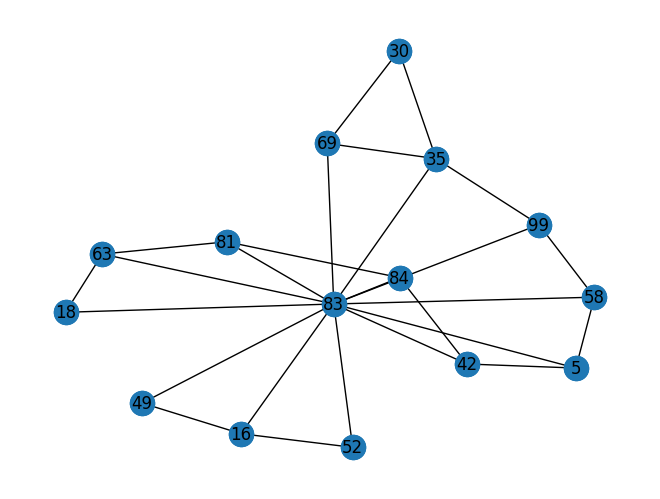

In [86]:
import matplotlib.pyplot as plt

node_labels = nx.get_node_attributes(spaces_g,'full_name')
# print(node_labels)

pos = nx.spring_layout(spaces_g)
nx.draw(spaces_g, pos = pos, with_labels=True)
# nx.draw_networkx_edge_labels(spaces_g, pos=pos, edge_labels = edge_labels, nod)
nx.draw_networkx_nodes(spaces_g.nodes, pos=pos, label=node_labels)
plt.show()

## Fusion

In [89]:
topologic_spaces = {}

for topology in topologies_list:
  d = Dictionary.PythonDictionary(Topology.Dictionary(topology))
  if d['category'] == 'Space':
    topologic_spaces[d['full_name']] = topology

print(len(topologic_spaces))

15


In [91]:
print(topologic_spaces.keys())

dict_keys(['IfcSpace/431', 'IfcSpace/432', 'IfcSpace/433', 'IfcSpace/415', 'IfcSpace/434', 'IfcSpace/430', 'IfcSpace/429', 'IfcSpace/416', 'IfcSpace/400', 'IfcSpace/440', 'IfcSpace/441', 'IfcSpace/439', 'IfcSpace/435', 'IfcSpace/462', 'IfcSpace/437'])


In [92]:
first_pair = [topologic_spaces['IfcSpace/431'], topologic_spaces['IfcSpace/432']]

Topology.Show(first_pair,
              renderer='colab',
              vertexSize=15,
              vertexLabelKey="full_name",
              vertexGroupKey="category",
              showVertexLabel=False,
              showVertexLegend=False,
              vertexGroups=['Slab', 'Wall', 'Space'])

# Neo4j

In [ ]:
neo4j_graph = Neo4j.ByParameters(URI, USER, PASSWORD)
print(neo4j_graph.session())

In [ ]:
neo4j_graph = Neo4j.ByGraph(neo4jGraph=neo4j_graph, graph=g)